In [78]:
import scipy.io as sio
import os

cylinder_all = sio.loadmat(os.path.join('..', 'DATA 2', 'FLUIDS', 'CYLINDER_ALL.mat'))

In [79]:
cylinder_all

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Fri Jan  6 08:31:36 2017',
 '__version__': '1.0',
 '__globals__': [],
 'UALL': array([[1.01243 , 1.01092 , 1.0096  , ..., 1.01776 , 1.01606 , 1.01434 ],
        [1.01186 , 1.01034 , 1.00902 , ..., 1.01725 , 1.01553 , 1.01379 ],
        [1.01119 , 1.00965 , 1.00833 , ..., 1.01663 , 1.01489 , 1.01313 ],
        ...,
        [0.893477, 0.872418, 0.856538, ..., 0.989162, 0.953848, 0.923323],
        [0.896224, 0.875572, 0.860087, ..., 0.99166 , 0.956212, 0.925753],
        [0.898832, 0.878495, 0.863317, ..., 0.994312, 0.958626, 0.928144]]),
 'UEXTRA': array([[1.01268 ],
        [1.01211 ],
        [1.01143 ],
        ...,
        [0.897089],
        [0.899783],
        [0.90235 ]]),
 'VALL': array([[-0.11537 , -0.115353, -0.115158, ..., -0.114324, -0.114821,
         -0.115171],
        [-0.116503, -0.116465, -0.11625 , ..., -0.115533, -0.116006,
         -0.116332],
        [-0.118006, -0.117951, -0.11772 , ..., -0.117081

In [80]:
u_all = cylinder_all['UALL']
v_all = cylinder_all['VALL']
m = int(cylinder_all['m'])
n = int(cylinder_all['n'])

/var/folders/h3/qyrdxv051fz35f8dd5n618b00000gn/T/ipykernel_19213/3085918305.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  m = int(cylinder_all['m'])
/var/folders/h3/qyrdxv051fz35f8dd5n618b00000gn/T/ipykernel_19213/3085918305.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n = int(cylinder_all['n'])


In [81]:
import numpy as np
import matplotlib.pyplot as plt

U, S, VT = np.linalg.svd(u_all, full_matrices=False)

In [82]:
cumsum = np.array([np.linalg.norm(np.diag(S[:r]), 'fro') ** 2 for r in range(len(S))]) / np.linalg.norm(np.diag(S), 'fro') ** 2

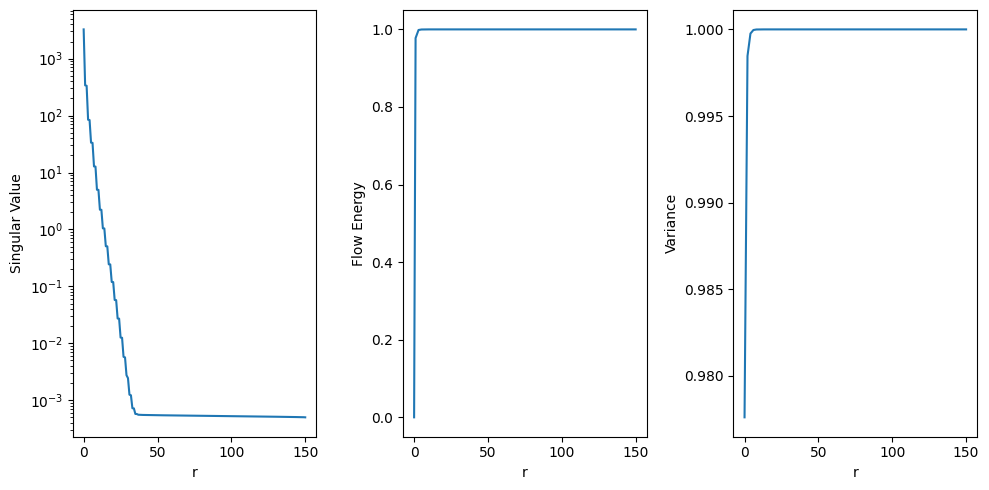

threshold 0


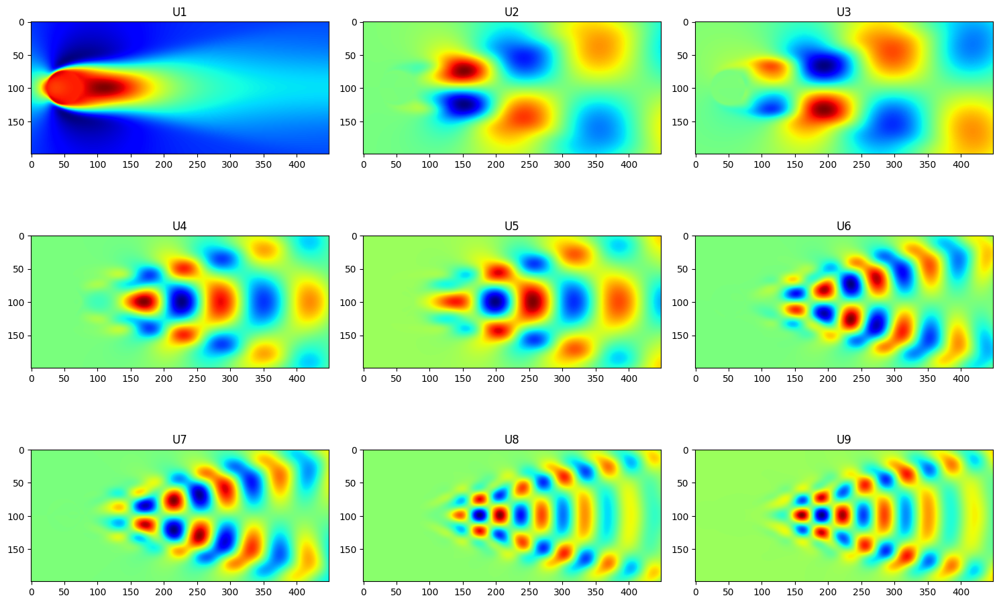

In [83]:
fig, axs = plt.subplots(1, 3, figsize=(10, 5))

axs[0].semilogy(S)
axs[0].set_ylabel('Singular Value')
axs[0].set_xlabel('r')
axs[1].plot(cumsum)
axs[1].set_ylabel('Flow Energy')
axs[1].set_xlabel('r')
axs[2].plot(np.cumsum(S ** 2) / np.sum(S ** 2))
axs[2].set_ylabel('Variance')
axs[2].set_xlabel('r')
plt.tight_layout()
plt.show()

threshold = np.min(np.where(cumsum <= 0.999))
print("threshold", threshold)

fig, axs = plt.subplots(3, 3, figsize=(15, 10))
for i, ax in enumerate(axs.flatten()):
    ax.imshow(U[:, i].reshape(n, m).T, cmap='jet')
    ax.set_title(f'U{i+1}')
plt.tight_layout()
plt.show()

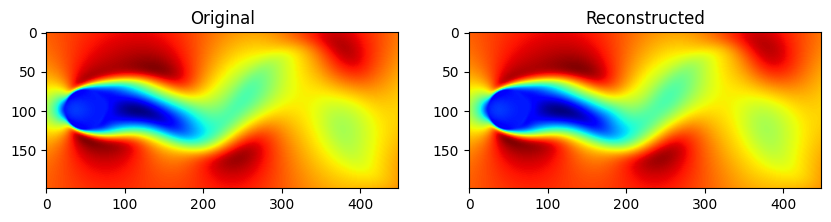

In [89]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

r = 10

# Assuming U, S, VT, u_all, n, m, and circle_index are already defined
reconstructed_flow = U[:, :r] @ np.diag(S[:r]) @ VT[:r, :]

# Number of frames in the animation
num_frames = 151

# Create the figure and axes objects
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Initialize the images
im1 = axs[0].imshow(u_all[:, 0].reshape(n, m).T, cmap='jet')
im2 = axs[1].imshow(reconstructed_flow[:, 0].reshape(n, m).T, cmap='jet')

# Set titles
axs[0].set_title('Original')
axs[1].set_title('Reconstructed')

# Define the update function
def update(frame):
    i = frame 
    im1.set_data(u_all[:, i].reshape(n, m).T)
    im2.set_data(reconstructed_flow[:, i].reshape(n, m).T)
    return im1, im2

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=num_frames, blit=True)

# Display the animation inline in the Jupyter notebook
HTML(ani.to_jshtml())

In [94]:
np.linalg.norm(u_all - reconstructed_flow, 'fro') ** 2

37.40494155137776

(89351,) (89351,)


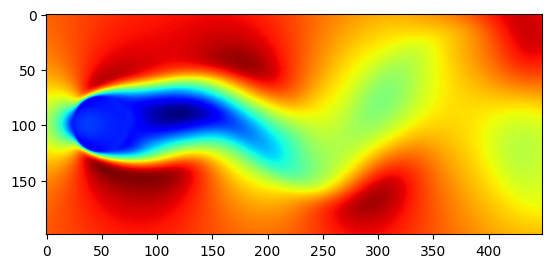

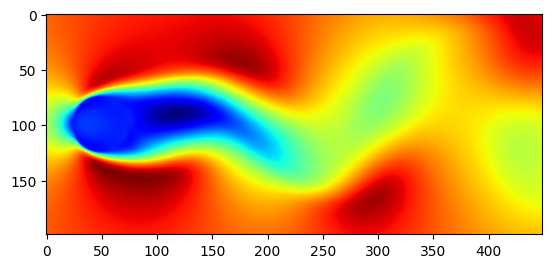

In [95]:
X_hat = U[:, :10] @ np.diag(S[:10]) @ VT[:10, :]
W = np.diag(S[:10]) @ VT[:10, :]
snapshot_hat = U[:, :10] @ W[:, 5]
snapshot = u_all[:, 5]
print(snapshot_hat.shape, snapshot.shape)
plt.imshow(snapshot_hat.reshape(n, m).T, cmap='jet')
plt.show()
plt.imshow(snapshot.reshape(n, m).T, cmap='jet')
plt.show()

(10, 30) (10, 151)


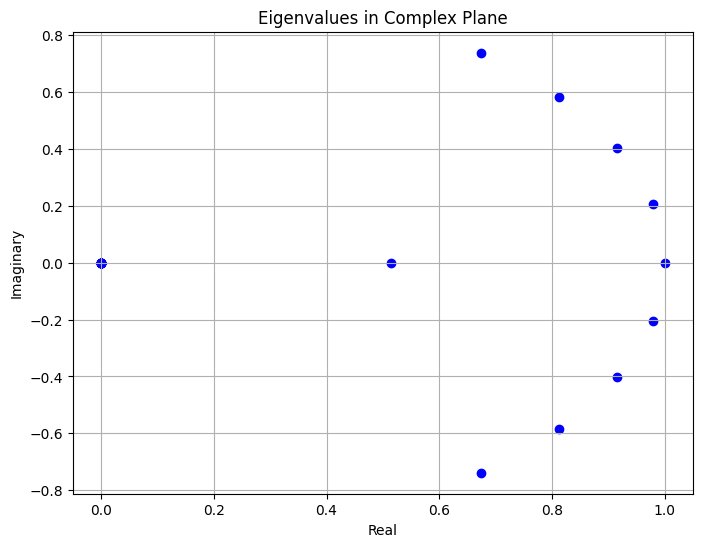

In [188]:
c = 30
P = W[:, :c]
print(P.shape, W.shape)
P_prime = W[:, 1:c+1]

# Solve for P_prime = A * P
A = np.linalg.pinv(P) @ P_prime
eigvals = np.linalg.eigvals(A)

plt.figure(figsize=(8, 6))
plt.scatter(eigvals.real, eigvals.imag, color='blue')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Eigenvalues in Complex Plane')
plt.grid(True)
plt.show()

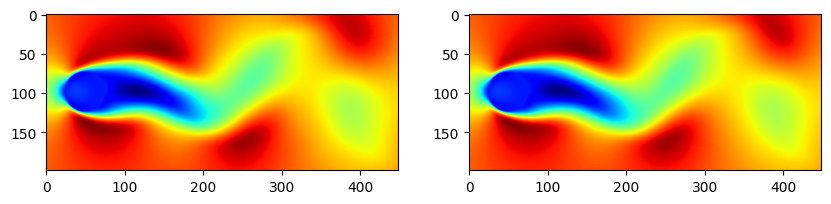

In [197]:

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Ensure the shapes are correct
im1 = axs[0].imshow((U[:, :10] @ P[:, 0]).reshape(n, m).T, cmap='jet')
im2 = axs[1].imshow(u_all[:, 0].reshape(n, m).T, cmap='jet')
plt.show()
reconstructed_flow = np.array([(U[:, :10] @ P @ (np.linalg.matrix_power(A, i - 1)))[:, 0] for i in range(1, 152)]).T

# Define the update function for animation
def update(frame):
    i = frame + 1
    im1.set_data(reconstructed_flow[:, i].reshape(n, m).T)
    im2.set_data(u_all[:, i].reshape(n, m).T)
    return im1, im2

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=150, blit=True)

# Display the animation inline in the Jupyter notebook
HTML(ani.to_jshtml())

In [202]:
np.linalg.norm(u_all - reconstructed_flow, 'fro') ** 2

62.2115973243129